<a href="https://colab.research.google.com/github/Himanshu-1703/colab_notebooks/blob/main/Effect_of_multicollinearity_on_regression_plane.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd
import numpy as np
from statsmodels.api import OLS,add_constant
import plotly.express as px
from sklearn.datasets import make_regression
import plotly.graph_objects as go

## Experimentation on synthetic data:

In [ ]:
# generate the data

X,y = make_regression(n_samples=500,
                      n_features=2,
                      n_informative=2,
                      noise=20,
                      random_state=65)

In [ ]:
# shape of X and y

print('The shape of X is',X.shape)
print('The shape of y is',y.shape)

The shape of X is (500, 2)
The shape of y is (500,)


In [ ]:
# define a plotting function

def plot_linear(X,y,estimator):
    # convert x and y to numpy arrays
    if type(X) != np.ndarray:
        X= X.values
        y = y.values

    # calculate the min and max values

    X1_min, X1_max = X[:,0].min(),X[:,0].max()
    X2_min, X2_max = X[:,1].min(),X[:,1].max()


    # generate the x and y arrays

    x_temp = np.linspace(X1_min,X1_max,500)
    y_temp = np.linspace(X2_min,X2_max,500)

    # generate meshgrid
    XX,YY = np.meshgrid(x_temp,y_temp)

    # generate the function arr
    arr = np.array([XX.ravel(),YY.ravel()]).T # transpose as well

    # pass the value of the arr through estimator
    cont = estimator.predict(arr)

    # reshape the cont
    cont = cont.reshape(XX.shape)

    # plot the function along with the data points
    fig = px.scatter_3d(x=X[:,0],y=X[:,1],z=y)
    fig.add_trace(trace=go.Surface(x=x_temp,y=y_temp,z=cont))
    fig.show()

In [ ]:
from sklearn.linear_model import LinearRegression

lr = LinearRegression()

# fit the model
lr.fit(X,y)

LinearRegression()

In [ ]:
# plot the graph for the generated data
plot_linear(X,y,estimator=lr)

In [ ]:
def gen_ols_summary(X,y):
    # add constant to the data
    X_temp = add_constant(X)

    # run statistical summary on the data

    ols = OLS(endog=y,exog=X_temp)


    # fit the OLS model
    results = ols.fit()

    # print the summary for the model
    return results.summary()

In [ ]:
# generate the OLS summary for the data
print(gen_ols_summary(X=X,y=y))

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.968
Model:                            OLS   Adj. R-squared:                  0.968
Method:                 Least Squares   F-statistic:                     7455.
Date:                Wed, 05 Jul 2023   Prob (F-statistic):               0.00
Time:                        12:53:09   Log-Likelihood:                -2208.4
No. Observations:                 500   AIC:                             4423.
Df Residuals:                     497   BIC:                             4435.
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          1.0277      0.901      1.140      0.2

## Actual Data

We import the cars data for seaborn to prove our concept.

In [ ]:
# take the cars dataset
from seaborn import load_dataset

df = load_dataset(name='mpg')

df.head()

,mpg,cylinders,displacement,horsepower,weight,acceleration,model_year,origin,name
0,18.0,8,307.0,130.0,3504,12.0,70,usa,chevrolet chevelle malibu
1,15.0,8,350.0,165.0,3693,11.5,70,usa,buick skylark 320
2,18.0,8,318.0,150.0,3436,11.0,70,usa,plymouth satellite
3,16.0,8,304.0,150.0,3433,12.0,70,usa,amc rebel sst
4,17.0,8,302.0,140.0,3449,10.5,70,usa,ford torino


In [ ]:
# take only the numerical columns and scale them

num_cols_df = df.select_dtypes(include=np.number)

from sklearn.preprocessing import StandardScaler

scaler = StandardScaler().set_output(transform='pandas')

# fit and transform the data
df = scaler.fit_transform(num_cols_df)

# print the first 5 rows
df.head()

,mpg,cylinders,displacement,horsepower,weight,acceleration,model_year
0,-0.706439,1.498191,1.090604,0.664133,0.630870,-1.295498,-1.627426
1,-1.090751,1.498191,1.503514,1.574594,0.854333,-1.477038,-1.627426
2,-0.706439,1.498191,1.196232,1.184397,0.550470,-1.658577,-1.627426
3,-0.962647,1.498191,1.061796,1.184397,0.546923,-1.295498,-1.627426
4,-0.834543,1.498191,1.042591,0.924265,0.565841,-1.840117,-1.627426


- scaling is performed for plotting purposes and also to get the correct values for correlation between our data.

Although the correlation numbers do not depend on the scale of the X and Y columns.

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

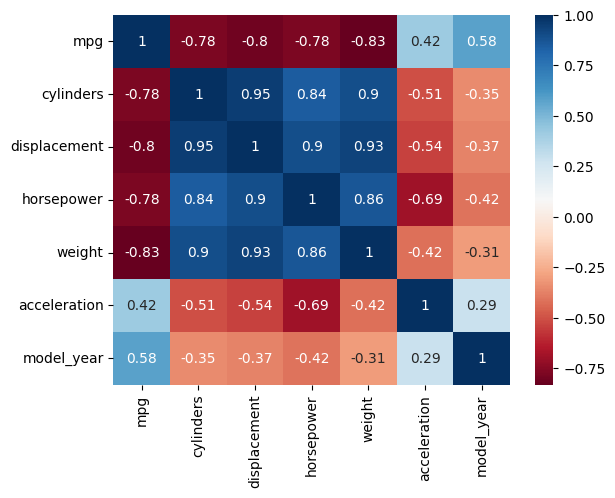

In [ ]:
# plot the correlation matrix

correlation = df.corr()


sns.heatmap(correlation,cmap='RdBu',
            annot=True)
plt.show()

**Correlation matrix was plotted to check the correlation between the input columns to check the sign for multicollinearity which is indicated by columns showing correlation above 0.8.**

In [ ]:
# drop the missing values

df.dropna(inplace=True)

In [ ]:
# calculate the VIF of all the columns
from statsmodels.stats.outliers_influence import variance_inflation_factor

vif = []

for col_idx in range(df.shape[1]):
    value = variance_inflation_factor(df,col_idx)
    vif.append(value)

vif_df = pd.DataFrame({'vif':vif},index=df.columns)
vif_df

,vif
mpg,5.243011
cylinders,10.661373
displacement,19.698480
horsepower,9.389062
weight,13.596793
acceleration,2.629135
model_year,1.907587


- high VIF values greater than 5 shows multicollinearity between the columns.

The formula for VIF is:
$$VIF=\dfrac{1}{1-R2}$$

this indicates that for VIF greater than 5, the other input columns are able to capture around 80 or more percentage variance of the desired input predicted column which indicates high multicollinearity.

In [ ]:
# choose columns having less correlation

df1 = df.loc[:,['cylinders','acceleration','mpg']].copy()
df2 = df.loc[:,['cylinders','displacement','mpg']].copy()


In [ ]:
# calculate the vif for df1

vif = []

for col_idx in range(df1.shape[1]):
    value = variance_inflation_factor(df1,col_idx)
    vif.append(value)

vif_df1 = pd.DataFrame({'vif':vif},index=df1.columns)
vif_df1

,vif
cylinders,2.795206
acceleration,1.346197
mpg,2.538060


- The VIF values for the columns showing lower correlation is less than 5.

In [ ]:
# calculate the vif for df2

vif = []

for col_idx in range(df2.shape[1]):
    value = variance_inflation_factor(df2,col_idx)
    vif.append(value)

vif_df1 = pd.DataFrame({'vif':vif},index=df2.columns)
vif_df1

,vif
cylinders,10.469958
displacement,11.765856
mpg,2.855328


- the VIF values for the columns with a higher correlation shows values greater than 10 which indicates a large amount of multicollinearity between the dependent columns

In [ ]:
# split the dependent and the independent columns
y1 = df1['mpg']
df1 = df1.drop(columns='mpg')

# split the dependent and the independent columns
y2 = df2['mpg']
df2 = df2.drop(columns='mpg')

df1_old = df1.copy()
df2_old = df2.copy()

In [ ]:
# plot the regression graph for df1

lr1 = LinearRegression()

# fit on df1

lr1.fit(df1.values,y1)

# plot the graph
plot_linear(X=df1,y=y1,estimator=lr1)

The slope of plane of the columns with less multicollinearity is stable and not very steep.

In [ ]:
# plot the regression graph for df2

lr2 = LinearRegression()

# fit on df1

lr2.fit(df2.values,y2)

# plot the graph
plot_linear(X=df2,y=y2,estimator=lr2)

The slope of the plane for columns showing multicollinearity is steep.

In [ ]:
# generate the summary for df1 and df2
print('OLS summary for data with no muticollinearity',end='\n\n')
df1_summary = gen_ols_summary(df1,y1)
print(df1_summary)
print('--' * 50)
print('--' * 50)
print('--' * 50)
print('OLS summary for data with muticollinearity',end='\n\n')
df2_summary = gen_ols_summary(df2,y2)
print(df2_summary)

OLS summary for data with no muticollinearity

                            OLS Regression Results                            
Dep. Variable:                    mpg   R-squared:                       0.606
Model:                            OLS   Adj. R-squared:                  0.604
Method:                 Least Squares   F-statistic:                     299.1
Date:                Wed, 05 Jul 2023   Prob (F-statistic):           2.14e-79
Time:                        12:53:15   Log-Likelihood:                -373.13
No. Observations:                 392   AIC:                             752.3
Df Residuals:                     389   BIC:                             764.2
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
                   coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------
c

In [ ]:
np.random.randint(low=0,high=len(df1),size=50)

array([ 37, 156, 197, 252, 203, 178, 322, 301, 300, 177, 291, 200,   7,
       198, 195, 295, 388, 390, 329,  52, 381, 214, 227, 120, 308, 290,
       318, 381, 219,  53,  92, 171, 307,  47, 179, 305, 264, 279, 106,
       142,  74,  82,  43,  90, 277, 239, 270,   6, 124, 165])

In [ ]:
# change some rows of data

# change cylinder column with mode and acceleration column with mean

cylinder_mode = df1['cylinders'].mode()
acc_mean = df1['acceleration'].mean()

# change the data for 50 rows with random index

# generate random index values
idx = np.random.randint(low=0,high=len(df1),size=50)

# change the values
df1.loc[idx,'cylinders'] = cylinder_mode[0]
df1.loc[idx,'acceleration'] = acc_mean

df1_new = df1.copy()

In [ ]:
# do the same for the data having multicollinearity

# change cylinder column with mode and displacement column with mean

cylinder_mode = df2['cylinders'].mode()
displace_mean = df2['displacement'].mean()

# change the data for 50 rows with random index

# generate random index values
idx = np.random.randint(low=0,high=len(df2),size=50)

# change the values
df2.loc[idx,'cylinders'] = cylinder_mode[0]
df2.loc[idx,'displacement'] = displace_mean

df2_new = df2.copy()

In [ ]:
# generate the summary for df1 and df2 after changing the rows
print('OLS summary for data with no muticollinearity',end='\n\n')
df1_summary_trans = gen_ols_summary(df1,y1)
print(df1_summary_trans)
print('--' * 50)
print('--' * 50)
print('--' * 50)
print('OLS summary for data with muticollinearity',end='\n\n')
df2_summary_trans = gen_ols_summary(df2,y2)
print(df2_summary_trans)

OLS summary for data with no muticollinearity

                            OLS Regression Results                            
Dep. Variable:                    mpg   R-squared:                       0.491
Model:                            OLS   Adj. R-squared:                  0.488
Method:                 Least Squares   F-statistic:                     187.3
Date:                Wed, 05 Jul 2023   Prob (F-statistic):           1.09e-57
Time:                        12:53:15   Log-Likelihood:                -423.49
No. Observations:                 392   AIC:                             853.0
Df Residuals:                     389   BIC:                             864.9
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
                   coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------
c

In [ ]:
# compare the results for data having no multicollinearity for the before and after
print(df1_summary)
print(df1_summary_trans)

                            OLS Regression Results                            
Dep. Variable:                    mpg   R-squared:                       0.606
Model:                            OLS   Adj. R-squared:                  0.604
Method:                 Least Squares   F-statistic:                     299.1
Date:                Wed, 05 Jul 2023   Prob (F-statistic):           2.14e-79
Time:                        12:53:15   Log-Likelihood:                -373.13
No. Observations:                 392   AIC:                             752.3
Df Residuals:                     389   BIC:                             764.2
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
                   coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------
const           -0.0008      0.032     -0.025   

In [ ]:
# compare the results for data having  multicollinearity for the before and after
print(df2_summary)
print(df2_summary_trans)

                            OLS Regression Results                            
Dep. Variable:                    mpg   R-squared:                       0.650
Model:                            OLS   Adj. R-squared:                  0.648
Method:                 Least Squares   F-statistic:                     360.8
Date:                Wed, 05 Jul 2023   Prob (F-statistic):           2.41e-89
Time:                        12:53:15   Log-Likelihood:                -350.04
No. Observations:                 392   AIC:                             706.1
Df Residuals:                     389   BIC:                             718.0
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
                   coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------
const           -0.0011      0.030     -0.036   

In [ ]:
def plot_comparison(X1,y1,X2,y2,estimator1,estimator2):
    def plot_linear(X,y,estimator):
        # convert x and y to numpy arrays
        if (type(X) != np.ndarray) and (type(y)!= np.ndarray):
            X= X.values
            y = y.values

        # calculate the min and max values

        X1_min, X1_max = X[:,0].min(),X[:,0].max()
        X2_min, X2_max = X[:,1].min(),X[:,1].max()


        # generate the x and y arrays

        x_temp = np.linspace(X1_min,X1_max,500)
        y_temp = np.linspace(X2_min,X2_max,500)

        # generate meshgrid
        XX,YY = np.meshgrid(x_temp,y_temp)

        # generate the function arr
        arr = np.array([XX.ravel(),YY.ravel()]).T # transpose as well

        # pass the value of the arr through estimator
        cont = estimator.predict(arr)

        # reshape the cont
        cont = cont.reshape(XX.shape)

        return x_temp,y_temp,cont


    # get the values for the contour plot
    x_old,y_old,cont_old = plot_linear(X1,y1,estimator1)
    x_new,y_new,cont_new = plot_linear(X2,y2,estimator2)


    # plot the function along with the data points
    fig = px.scatter_3d(x=X1[:,0],y=X1[:,1],z=y1)
    fig.add_trace(trace=go.Surface(x=x_old,y=y_old,z=cont_old,showscale=False))
    fig.add_trace(trace=go.Surface(x=x_new,y=y_new,z=cont_new))

    fig.show()


In [ ]:
df1_old.shape

(392, 2)

In [ ]:
df1_new.shape

(392, 2)

In [ ]:
# fit a new linear regression on old and new data

data_objs = [[df1_old,df1_new],[df2_old,df2_new]]

lr_objs = []

for data in data_objs:
    lr_old = LinearRegression()
    lr_new = LinearRegression()

    # fit on the data
    lr_old.fit(data[0],y1)
    lr_new.fit(data[1],y1)

    lr_objs.append(lr_old)
    lr_objs.append(lr_new)

In [ ]:
from warnings import filterwarnings

filterwarnings('ignore')

In [ ]:
# plot comparison graph for the df with very less multicollinearity

plot_comparison(X1=df1_old.values,y1=y1,X2=df1_new.values,y2=y2,estimator1=lr_objs[0],estimator2=lr_objs[1])

Slight change in the data in the training set shows that the coef values are stable and does not change much when the columns are not multicollinear with each other.

In [ ]:
# plot comparison graph for the df with very high multicollinearity

plot_comparison(X1=df2_old.values,y1=y1,X2=df2_new.values,y2=y2,estimator1=lr_objs[2],estimator2=lr_objs[3])

The columns when are having multicollinearity shows a large shift in the coef values due to change in small part of the training set and also shows that due to multicollinearity, the coef of the model are unstable in nature and change drastically along with the slight change in the data in the training set.